Устинов Иван Вадимович

In [1]:
%matplotlib inline

In [2]:
import torchvision.models as models
import torchvision.transforms as transforms
import torch
from torch.autograd import Variable
import numpy as np
from PIL import Image
import copy

from IPython.display import display

In [3]:
mean=[0.485, 0.456, 0.406] 
std=[0.229, 0.224, 0.225]
trans = transforms.Compose([
            transforms.Normalize(mean, std)
        ])
    
def numpy2image(img_numpy):
    if img_numpy.dtype == np.dtype('float64'): #нужно домножить на 255 и поменять тип
        img_numpy = (img_numpy*255).astype('uint8')
    return Image.fromarray(img_numpy)

# [DeepDream](https://research.googleblog.com/2015/06/inceptionism-going-deeper-into-neural.html)
Используем тот же самый метод Gradient Ascent. Только в этом случае усиливаем действие не одного нейрона а всей группы на слое
1. Пропускаем картинку через сеть
2. Устанавливаем градиент выбранного слоя (не нейрона) равным их активации (dx=x)
3. Делаем backward
4. Обновляем картинку <br/>
В нашем случае функция, которую мы максимизируем
$$ I^* = arg max ( \sum_i f_i (I)^2) $$

Дополнительно, делают:
1. смешения картинки (то есть при каждой итерации циклически поворачивают картинку) np.roll + 
2. нормализацию градиента (на среднее или l1 норму)
3. клип значений пикселей np.clip - чтобы срезать значения ниже 0 и выше 1

![DeepDream](./img/DeepDream.png)

---
Можно модифицировать код выше:
* взять нужный слой, заменив AlexNet на FeaturesExtractor
* сделав небольшие смещения входной картинки. 
* на вход подовать не шум, а изображение

In [4]:
img_deep_dream =  np.asarray(Image.open('_image.jpg')) / 255.0

In [19]:
img_deep_dream.dtype == np.dtype('float64')

True

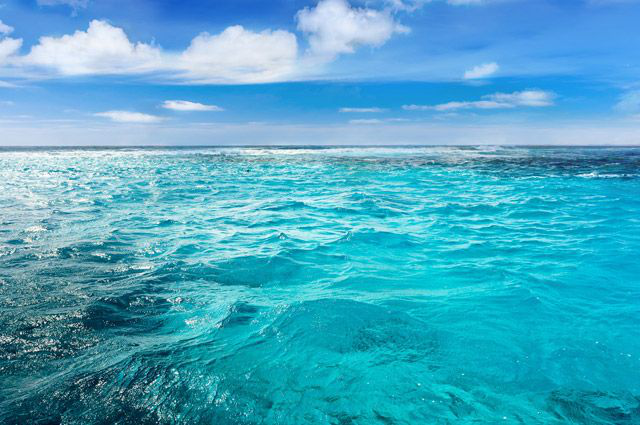

In [5]:
numpy2image(img_deep_dream)

In [18]:
# #Пример как сделать forward до заданного слоя в resnet
# net = models.resnet34(pretrained=True)

# def my_forward(self, x):
#     x = self.conv1(x)
#     x = self.bn1(x)
#     x = self.relu(x)
#     x = self.maxpool(x)

#     x = self.layer1(x)

#     return x

# in_img = torch.from_numpy(img).transpose(2,1).transpose(1,0).float()
# in_img = Variable(trans(in_img).unsqueeze(0), requires_grad=True)
# my_forward(net, in_img)

Downloading: "https://download.pytorch.org/models/resnet34-333f7ec4.pth" to /home/a.murashev/.torch/models/resnet34-333f7ec4.pth
100%|██████████| 87306240/87306240 [00:04<00:00, 21312996.69it/s]


In [6]:
net = models.resnet34(pretrained=True)

In [20]:
print(net.layer1[0])

BasicBlock(
  (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace)
  (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
)


## Задание 1
#### Применить всю сеть без fullconnected слоев (должны получить лица животных и что-то визуально внятное)

In [24]:
def my_forward(self, x):
    x = self.conv1(x)
    x = self.bn1(x)
    x = self.relu(x)
    x = self.maxpool(x)

    x = self.layer1(x)
    x = self.layer2(x)
    x = self.layer3(x)
    x = self.layer4(x)

    return x

Iter 0


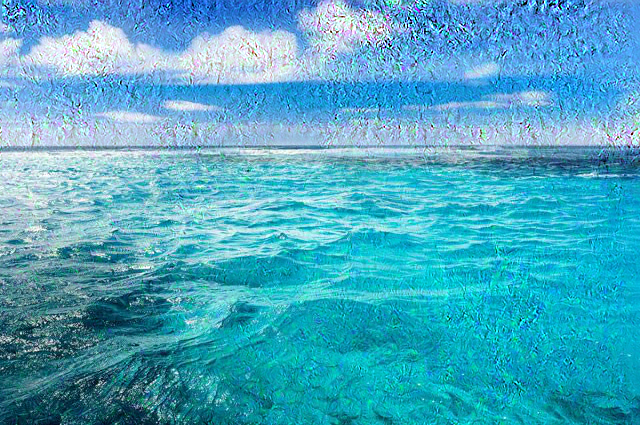


Iter 5


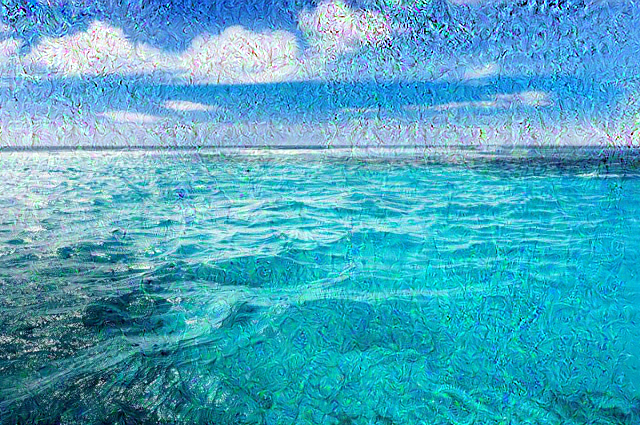


Iter 10


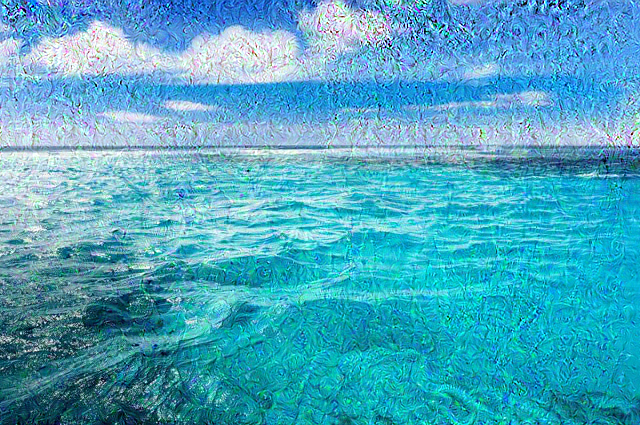


Iter 15


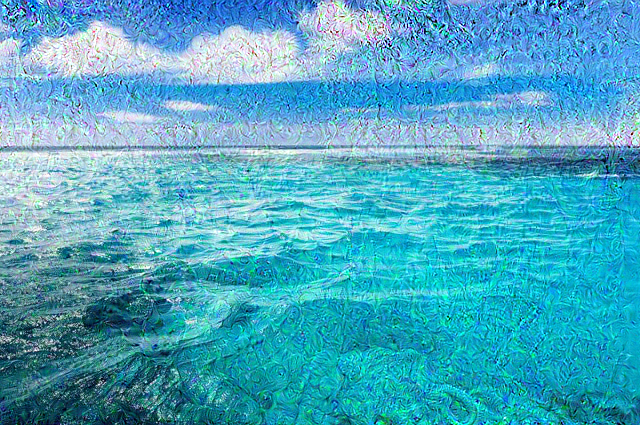


Iter 20


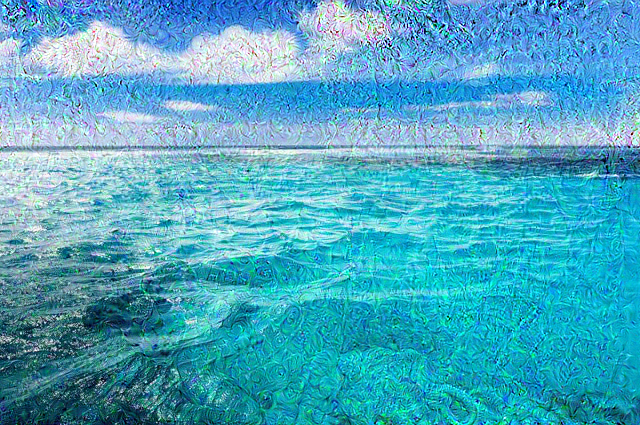


Iter 25


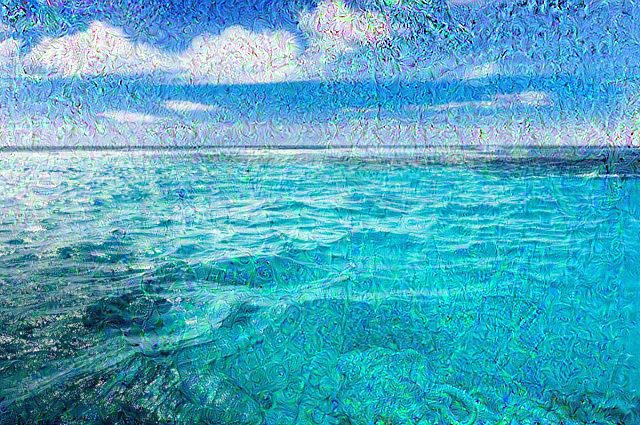


Iter 30


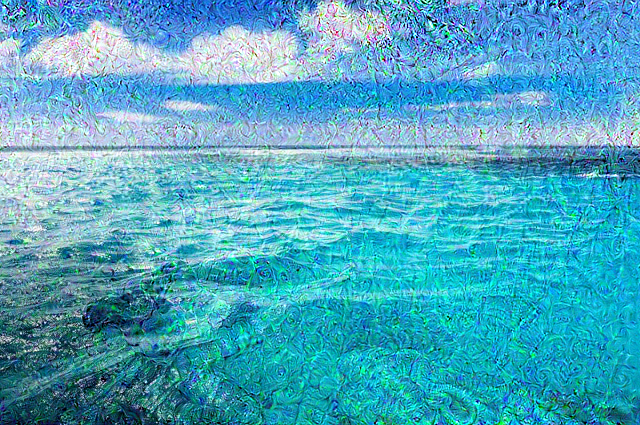


Iter 35


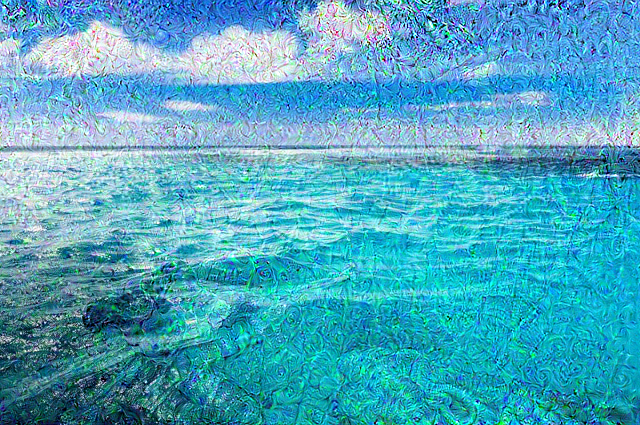


Iter 40


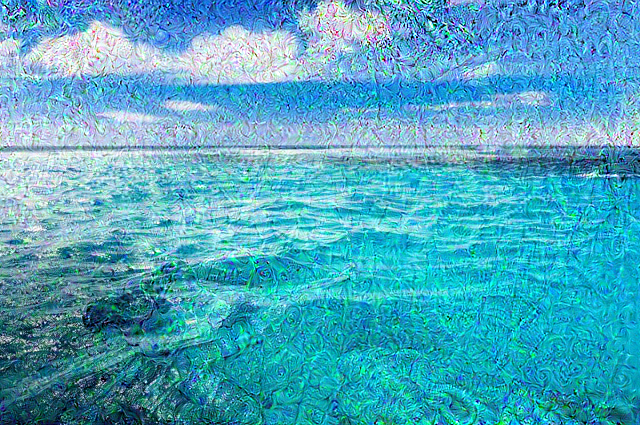


Iter 45


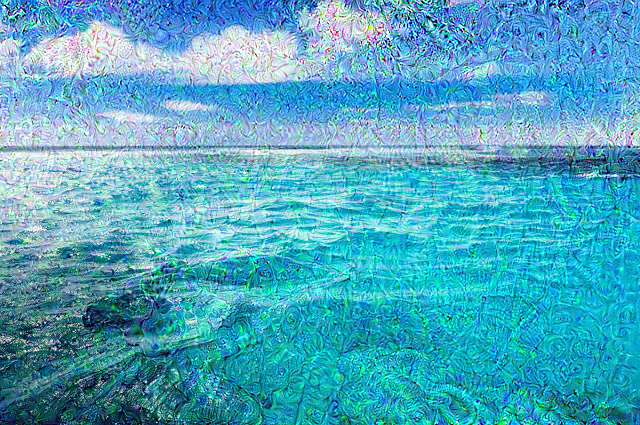


Iter 50


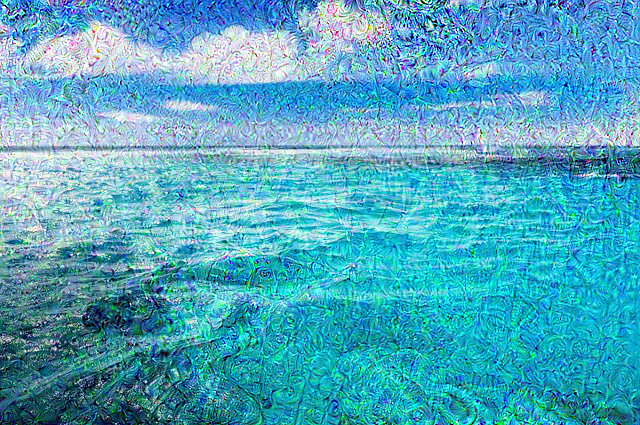


Iter 55


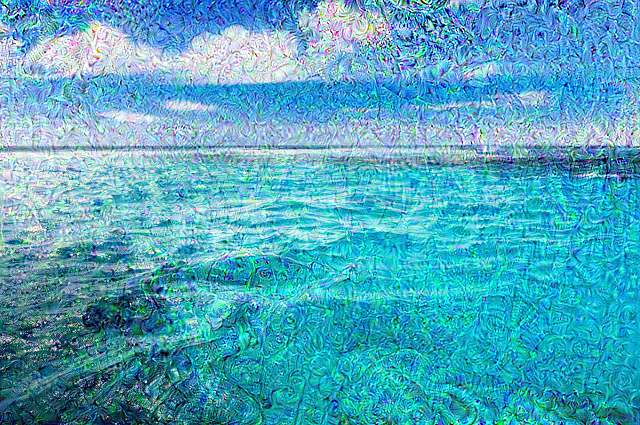


Iter 60


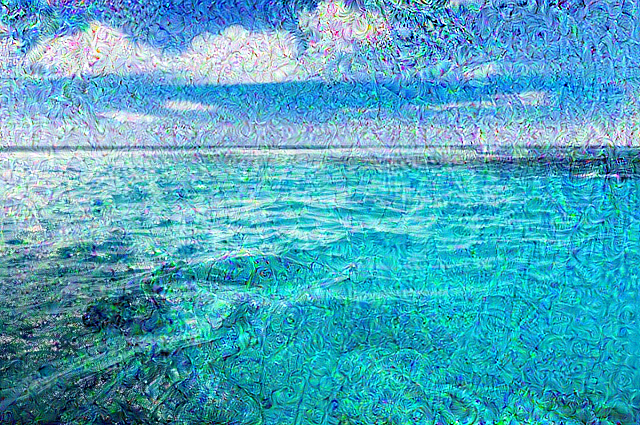


Iter 65


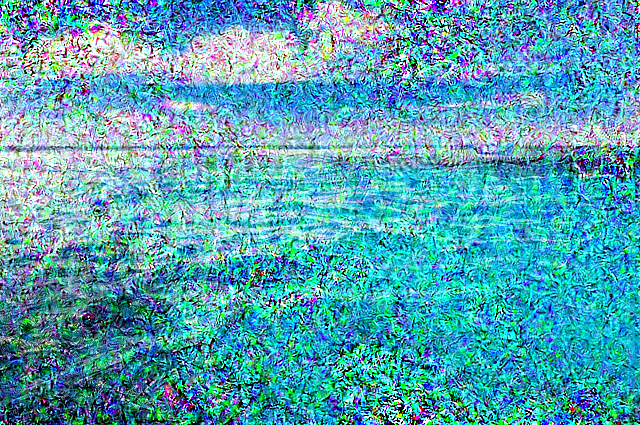


Iter 70


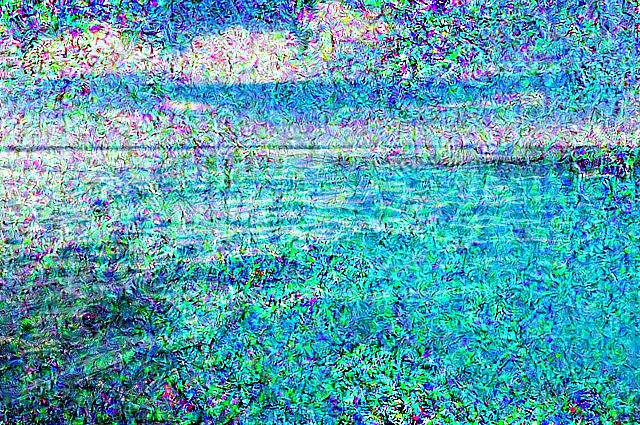


Iter 75


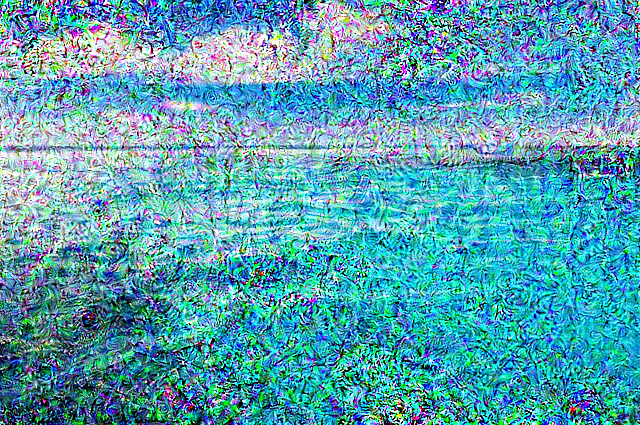


Iter 80


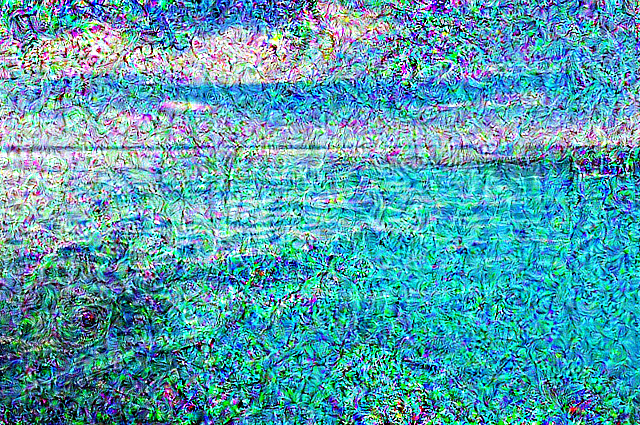


Iter 85


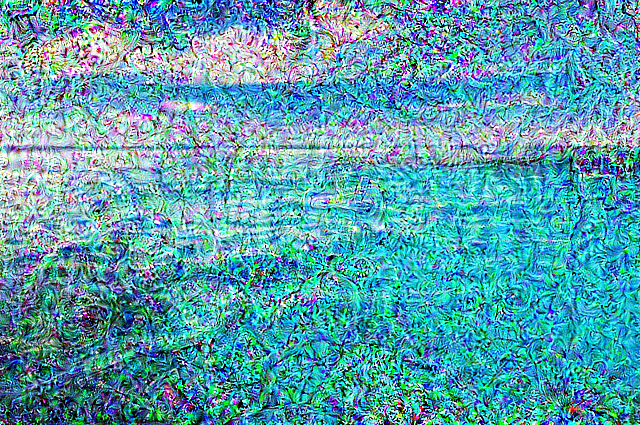

In [ ]:
img = copy.deepcopy(img_deep_dream)

max_jitter = 32
step_size = 0.000001
TRACE_ITER = 5
for iter_id in range(100):

    shift_x, shift_y = np.random.randint( -max_jitter, max_jitter + 1, 2)
    img = np.roll(np.roll(img, shift_x, -1), shift_y, -2)

    in_img = torch.from_numpy(img).transpose(2,1).transpose(1,0).float()
    in_img = Variable(trans(in_img).unsqueeze(0), requires_grad=True) # тут нам нужен будет градиент
    
    #forward до нужного слоя
    out = my_forward(net, in_img)
    #backward dx=x
    out.backward(gradient=out.data, retain_graph=True)

    grad = in_img.grad.data
    grad = grad[0, :, :, :]
    grad =  grad.transpose(0,1).transpose(1,2).numpy() #превращаем градиент в numpy 

    #обновление картинки img
    img += step_size * grad / np.abs(np.mean(grad))

    img = np.roll(np.roll(img, -shift_x, -1), -shift_y, -2)
    img = np.clip(img, 0, 1)
    if iter_id % TRACE_ITER == 0:
        print("Iter %d" % iter_id)
        display(numpy2image(img))
        print()
        
print("Iter %d" % iter_id)
display(numpy2image(img))
print()

## Задание 2

#### Сделать deep dream по нижним слоям (после 1-2 конволюций) - должы закрасить некоторой текстурой картинку в итоге

In [21]:
def my_forward(self, x):
    x = self.conv1(x)
    x = self.layer1[0].conv1(x)

    return x

In [22]:
img = copy.deepcopy(img_deep_dream)

max_jitter = 32
step_size = 0.0001
TRACE_ITER = 5
for iter_id in range(100):

    shift_x, shift_y = np.random.randint( -max_jitter, max_jitter + 1, 2)
    img = np.roll(np.roll(img, shift_x, -1), shift_y, -2)

    in_img = torch.from_numpy(img).transpose(2,1).transpose(1,0).float()
    in_img = Variable(trans(in_img).unsqueeze(0), requires_grad=True) # тут нам нужен будет градиент
    
    #forward до нужного слоя
    out = my_forward(net, in_img)
    #backward dx=x
    out.backward(gradient=out.data, retain_graph=True)

    grad = in_img.grad.data
    grad = grad[0, :, :, :]
    grad =  grad.transpose(0,1).transpose(1,2).numpy() #превращаем градиент в numpy 

    #обновление картинки img
    img += step_size * grad / np.abs(np.mean(grad))

    img = np.roll(np.roll(img, -shift_x, -1), -shift_y, -2)
    img = np.clip(img, 0, 1)
    if iter_id % TRACE_ITER == 0:
        print("Iter %d" % iter_id)

Iter 0
Iter 5
Iter 10
Iter 15
Iter 20
Iter 25
Iter 30
Iter 35
Iter 40
Iter 45
Iter 50
Iter 55
Iter 60
Iter 65
Iter 70
Iter 75
Iter 80
Iter 85
Iter 90
Iter 95


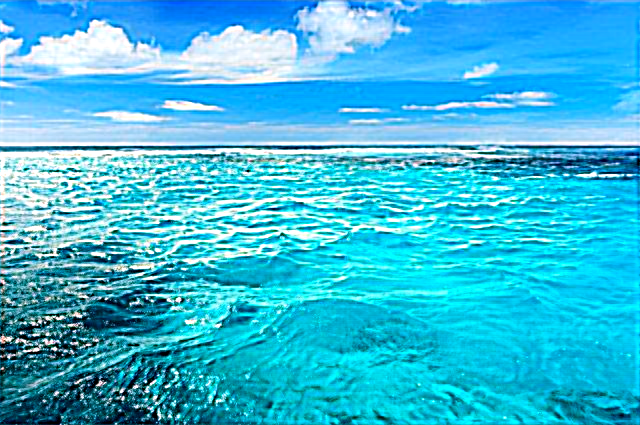

In [23]:
numpy2image(img)

## Задание 3
#### Сделать deep dream по средним слоям - должы закрасить некоторыми осмысленными узорами картинку в итоге

In [24]:
def my_forward(self, x):
    x = self.conv1(x)
    x = self.bn1(x)
    x = self.relu(x)
    x = self.maxpool(x)

    x = self.layer1(x)
    x = self.layer2(x)

    return x

In [25]:
img = copy.deepcopy(img_deep_dream)

max_jitter = 32
step_size = 0.000003   
TRACE_ITER = 5
for iter_id in range(100):

    shift_x, shift_y = np.random.randint( -max_jitter, max_jitter + 1, 2)
    img = np.roll(np.roll(img, shift_x, -1), shift_y, -2)

    in_img = torch.from_numpy(img).transpose(2,1).transpose(1,0).float()
    in_img = Variable(trans(in_img).unsqueeze(0), requires_grad=True) # тут нам нужен будет градиент
    
    #forward до нужного слоя
    out = my_forward(net, in_img)
    #backward dx=x
    out.backward(gradient=out.data, retain_graph=True)

    grad = in_img.grad.data
    grad = grad[0, :, :, :]
    grad =  grad.transpose(0,1).transpose(1,2).numpy() #превращаем градиент в numpy 

    #обновление картинки img
    img += step_size * grad / np.abs(np.mean(grad))

    img = np.roll(np.roll(img, -shift_x, -1), -shift_y, -2)
    img = np.clip(img, 0, 1)
    if iter_id % TRACE_ITER == 0:
        print("Iter %d" % iter_id)

Iter 0
Iter 5
Iter 10
Iter 15
Iter 20
Iter 25
Iter 30
Iter 35
Iter 40
Iter 45
Iter 50
Iter 55
Iter 60
Iter 65
Iter 70
Iter 75
Iter 80
Iter 85
Iter 90
Iter 95


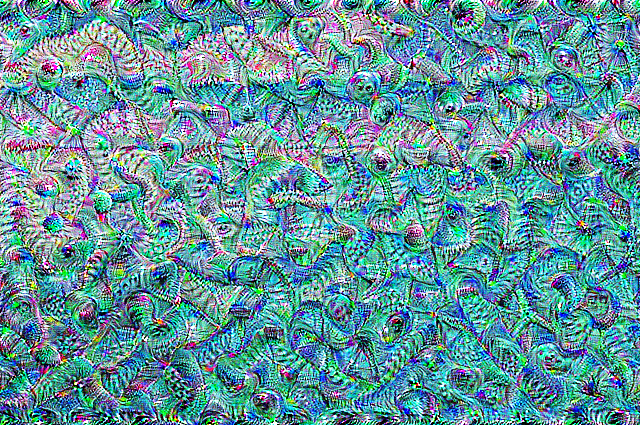

In [26]:
numpy2image(img)

#### для Alexnet

In [27]:
net = models.alexnet(pretrained=True)

Downloading: "https://download.pytorch.org/models/alexnet-owt-4df8aa71.pth" to /home/ivan.ustinov/.torch/models/alexnet-owt-4df8aa71.pth
244418560it [00:08, 28249560.08it/s]


In [28]:
print(net)

AlexNet(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(11, 11), stride=(4, 4), padding=(2, 2))
    (1): ReLU(inplace)
    (2): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (3): Conv2d(64, 192, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
    (4): ReLU(inplace)
    (5): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (6): Conv2d(192, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (7): ReLU(inplace)
    (8): Conv2d(384, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (9): ReLU(inplace)
    (10): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace)
    (12): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (avgpool): AdaptiveAvgPool2d(output_size=(6, 6))
  (classifier): Sequential(
    (0): Dropout(p=0.5)
    (1): Linear(in_features=9216, out_features=4096, bias=True)
    (2): ReLU(inplace)
    (3): Dropout(p

In [29]:
def my_forward(self, x):
    x = self.features(x)

    return x

img = copy.deepcopy(img_deep_dream)

max_jitter = 32
step_size = 0.00001   
TRACE_ITER = 5
for iter_id in range(500):

    shift_x, shift_y = np.random.randint( -max_jitter, max_jitter + 1, 2)
    img = np.roll(np.roll(img, shift_x, -1), shift_y, -2)

    in_img = torch.from_numpy(img).transpose(2,1).transpose(1,0).float()
    in_img = Variable(trans(in_img).unsqueeze(0), requires_grad=True) # тут нам нужен будет градиент
    
    #forward до нужного слоя
    out = my_forward(net, in_img)
    #backward dx=x
    out.backward(gradient=out.data, retain_graph=True)

    grad = in_img.grad.data
    grad = grad[0, :, :, :]
    grad =  grad.transpose(0,1).transpose(1,2).numpy() #превращаем градиент в numpy 

    #обновление картинки img
    img += step_size * grad / np.abs(np.mean(grad))

    img = np.roll(np.roll(img, -shift_x, -1), -shift_y, -2)
    img = np.clip(img, 0, 1)
    if iter_id % TRACE_ITER == 0:
        print("Iter %d" % iter_id)

Iter 0
Iter 5
Iter 10
Iter 15
Iter 20
Iter 25
Iter 30
Iter 35
Iter 40
Iter 45
Iter 50
Iter 55
Iter 60
Iter 65
Iter 70
Iter 75
Iter 80
Iter 85
Iter 90
Iter 95
Iter 100
Iter 105
Iter 110
Iter 115
Iter 120
Iter 125
Iter 130
Iter 135
Iter 140
Iter 145
Iter 150
Iter 155
Iter 160
Iter 165
Iter 170
Iter 175
Iter 180
Iter 185
Iter 190
Iter 195
Iter 200
Iter 205
Iter 210
Iter 215
Iter 220
Iter 225
Iter 230
Iter 235
Iter 240
Iter 245
Iter 250
Iter 255
Iter 260
Iter 265
Iter 270
Iter 275
Iter 280
Iter 285
Iter 290
Iter 295
Iter 300
Iter 305
Iter 310
Iter 315
Iter 320
Iter 325
Iter 330
Iter 335
Iter 340
Iter 345
Iter 350
Iter 355
Iter 360
Iter 365
Iter 370
Iter 375
Iter 380
Iter 385
Iter 390
Iter 395
Iter 400
Iter 405
Iter 410
Iter 415
Iter 420
Iter 425
Iter 430
Iter 435
Iter 440
Iter 445
Iter 450
Iter 455
Iter 460
Iter 465
Iter 470
Iter 475
Iter 480
Iter 485
Iter 490
Iter 495


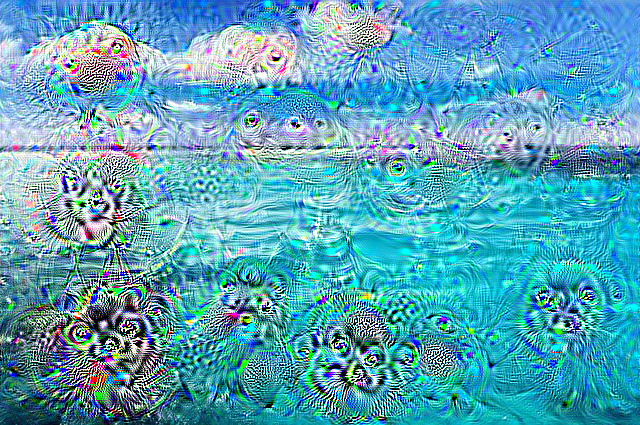

In [30]:
numpy2image(img)

In [31]:
def my_forward(self, x):
    x = self.features[0](x)
    x = self.features[1](x)
    x = self.features[2](x)
    x = self.features[3](x)
    
    return x

img = copy.deepcopy(img_deep_dream)

max_jitter = 32
step_size = 0.0001   
TRACE_ITER = 5
for iter_id in range(100):

    shift_x, shift_y = np.random.randint( -max_jitter, max_jitter + 1, 2)
    img = np.roll(np.roll(img, shift_x, -1), shift_y, -2)

    in_img = torch.from_numpy(img).transpose(2,1).transpose(1,0).float()
    in_img = Variable(trans(in_img).unsqueeze(0), requires_grad=True) # тут нам нужен будет градиент
    
    #forward до нужного слоя
    out = my_forward(net, in_img)
    #backward dx=x
    out.backward(gradient=out.data, retain_graph=True)

    grad = in_img.grad.data
    grad = grad[0, :, :, :]
    grad =  grad.transpose(0,1).transpose(1,2).numpy() #превращаем градиент в numpy 

    #обновление картинки img
    img += step_size * grad / np.abs(np.mean(grad))

    img = np.roll(np.roll(img, -shift_x, -1), -shift_y, -2)
    img = np.clip(img, 0, 1)
    if iter_id % TRACE_ITER == 0:
        print("Iter %d" % iter_id)

Iter 0
Iter 5
Iter 10
Iter 15
Iter 20
Iter 25
Iter 30
Iter 35
Iter 40
Iter 45
Iter 50
Iter 55
Iter 60
Iter 65
Iter 70
Iter 75
Iter 80
Iter 85
Iter 90
Iter 95


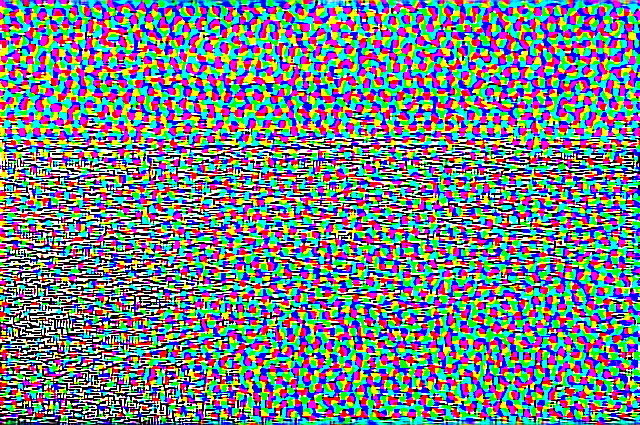

In [32]:
numpy2image(img)